```
This software is part of GPU Ocean. 

Copyright (C) 2022 SINTEF Digital

Looking at daily mean files from NorKyst800, potentially for use for
baroclinic models.

This program is free software: you can redistribute it and/or modify
it under the terms of the GNU General Public License as published by
the Free Software Foundation, either version 3 of the License, or
(at your option) any later version.

This program is distributed in the hope that it will be useful,
but WITHOUT ANY WARRANTY; without even the implied warranty of
MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.  See the
GNU General Public License for more details.

You should have received a copy of the GNU General Public License
along with this program.  If not, see <http://www.gnu.org/licenses/>.
```

# Daily mean

In [117]:
#Lets have matplotlib "inline"
%matplotlib inline

import os
import sys

#Import packages we need
import numpy as np
import datetime
from datetime import timedelta
from netCDF4 import Dataset
from IPython.display import display

import xarray as xr

#For plotting
import matplotlib
from matplotlib import pyplot as plt
import matplotlib as mpl
from matplotlib import animation, rc
plt.rcParams["animation.html"] = "jshtml"
mpl.rcParams['figure.facecolor'] = 'white'

In [2]:
from gpuocean.SWEsimulators import CDKLM16
from gpuocean.utils import Common, IPythonMagic, NetCDFInitialization
from gpuocean.drifters import GPUDrifterCollection

In [111]:
%cuda_context_handler gpu_ctx

In [14]:
#source_url = 'https://thredds.met.no/thredds/dodsC/fou-hi/norkyst800m-1h/NorKyst-800m_ZDEPTHS_his.an.2019071600.nc'
source_url  = 'https://thredds.met.no/thredds/dodsC/fou-hi/norkyst800m/NorKyst-800m_ZDEPTHS_avg.an.2019071600.nc'
source_url1 = 'https://thredds.met.no/thredds/dodsC/fou-hi/norkyst800m/NorKyst-800m_ZDEPTHS_avg.an.2019071700.nc'
source_url2 = 'https://thredds.met.no/thredds/dodsC/fou-hi/norkyst800m/NorKyst-800m_ZDEPTHS_avg.an.2019071800.nc'


casename = 'lofoten'

case_info = NetCDFInitialization.getCaseLocation(casename)
print(case_info["name"])

ds  = xr.open_dataset(source_url)
ds1 = xr.open_dataset(source_url1)
ds2 = xr.open_dataset(source_url2)


ds

lofoten


<xarray.Dataset>
Dimensions:                  (s_rho: 35, s_w: 36, X: 2602, Y: 902, depth: 16, time: 1)
Coordinates:
  * X                        (X) float64 0.0 800.0 ... 2.08e+06 2.081e+06
  * Y                        (Y) float64 0.0 800.0 1.6e+03 ... 7.2e+05 7.208e+05
  * depth                    (depth) float64 0.0 3.0 10.0 ... 1e+03 2e+03 3e+03
  * time                     (time) datetime64[ns] 2019-07-16T12:00:00
    lat                      (Y, X) float64 ...
    lon                      (Y, X) float64 ...
Dimensions without coordinates: s_rho, s_w
Data variables: (12/21)
    Cs_r                     (s_rho) float64 ...
    Cs_w                     (s_w) float64 ...
    Uwind                    int32 ...
    Vwind                    int32 ...
    forecast_reference_time  datetime64[ns] ...
    hc                       float64 ...
    ...                       ...
    ubar                     (time, Y, X) float32 ...
    v                        (time, depth, Y, X) float32 ...
    v_northward              (time, depth, Y, X) float32 ...
    vbar                     (time, Y, X) float32 ...
    w                        (time, depth, Y, X) float32 ...
    zeta                     (time, Y, X) float32 ...
Attributes: (12/33)
    file:                            /home/metno_op/run/norkyst-800m_2017/oce...
    type:                            ROMS/TOMS nonlinear model averages file
    title:                           NorKyst-800m - ROMS
    var_info:                        /home/metno_op/sea/ROMS/metroms/apps/com...
    rst_file:                        /home/metno_op/run/norkyst-800m_2017/oce...
    avg_file:                        /home/metno_op/run/norkyst-800m_2017/oce...
    ...                              ...
    CPP_options:                     NORKYST800M, ADD_FSOBC, ADD_M2OBC, ALBED...
    Conventions:                     CF-1.4, SGRID-0.3
    history:                         Tue Jul 16 04:05:28 2019: ncks -O --4 -d...
    history_of_appended_files:       Tue Jul 16 04:05:28 2019: Appended file ...
    NCO:                             "4.5.4"
    DODS_EXTRA.Unlimited_Dimension:  time

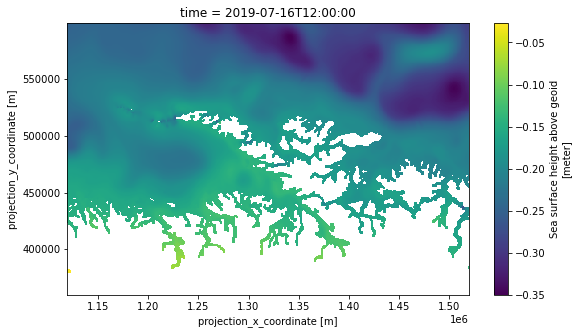

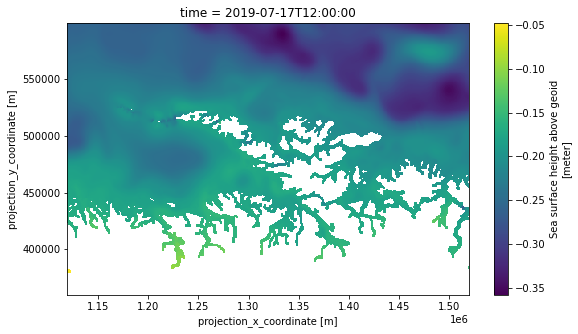

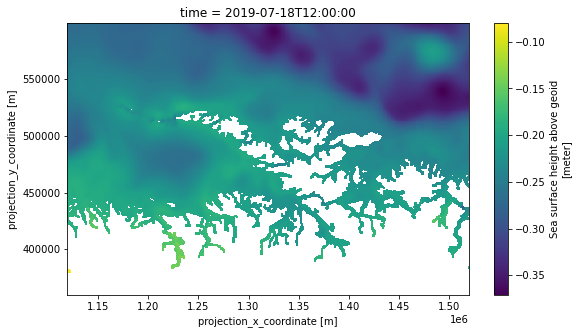

In [17]:
ds.zeta.isel(X=slice(case_info["x0"], case_info["x1"]), Y=slice(case_info["y0"], case_info["y1"])).plot(figsize=(9,5))
ds1.zeta.isel(X=slice(case_info["x0"], case_info["x1"]), Y=slice(case_info["y0"], case_info["y1"])).plot(figsize=(9,5))
ds2.zeta.isel(X=slice(case_info["x0"], case_info["x1"]), Y=slice(case_info["y0"], case_info["y1"])).plot(figsize=(9,5))


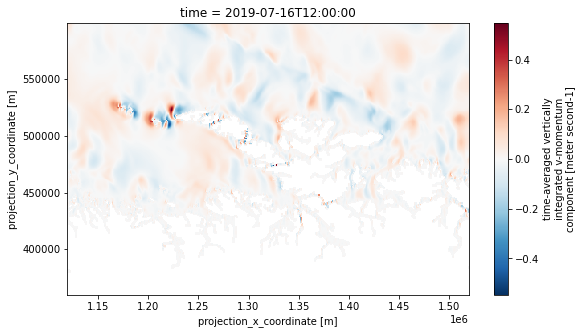

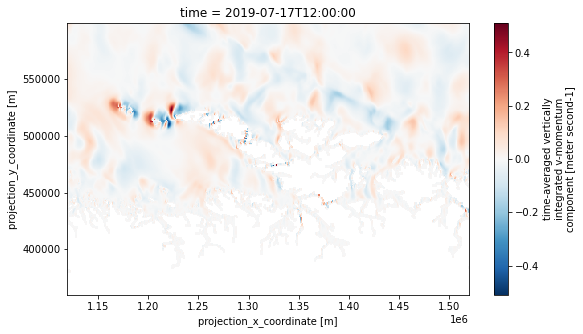

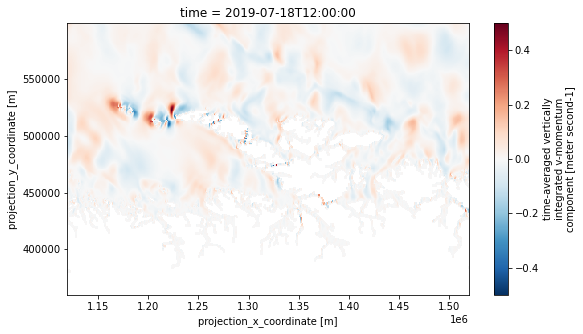

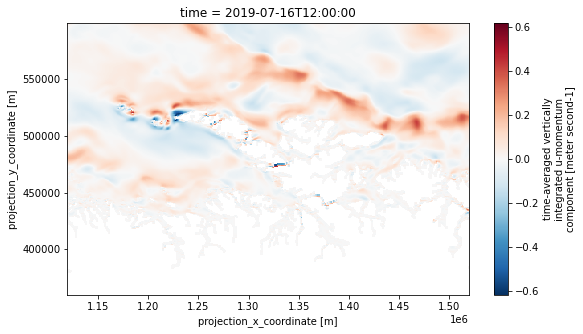

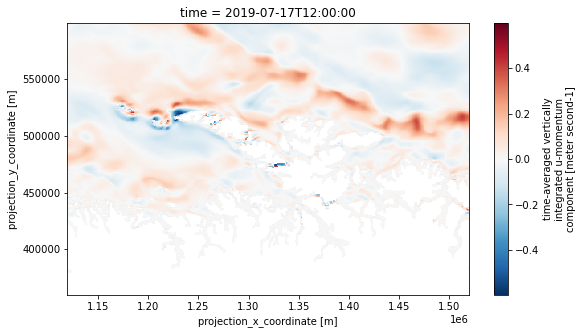

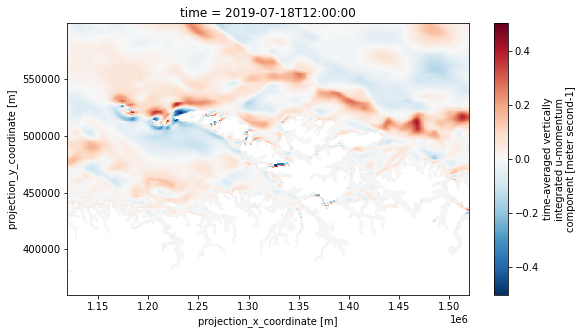

In [18]:
ds.vbar.isel(X=slice(case_info["x0"], case_info["x1"]), Y=slice(case_info["y0"], case_info["y1"])).plot(figsize=(9,5))
ds1.vbar.isel(X=slice(case_info["x0"], case_info["x1"]), Y=slice(case_info["y0"], case_info["y1"])).plot(figsize=(9,5))
ds2.vbar.isel(X=slice(case_info["x0"], case_info["x1"]), Y=slice(case_info["y0"], case_info["y1"])).plot(figsize=(9,5))
ds.ubar.isel(X=slice(case_info["x0"], case_info["x1"]), Y=slice(case_info["y0"], case_info["y1"])).plot(figsize=(9,5))
ds1.ubar.isel(X=slice(case_info["x0"], case_info["x1"]), Y=slice(case_info["y0"], case_info["y1"])).plot(figsize=(9,5))
ds2.ubar.isel(X=slice(case_info["x0"], case_info["x1"]), Y=slice(case_info["y0"], case_info["y1"])).plot(figsize=(9,5))


In [28]:
slicex=slice(case_info["x0"], case_info["x1"])
slicey=slice(case_info["y0"], case_info["y1"])

diff_eta_1 = ds.zeta.isel(X=slicex, Y=slicey, time=0).data - ds1.zeta.isel(X=slicex, Y=slicey, time=0).data
diff_eta_2 = ds.zeta.isel(X=slicex, Y=slicey, time=0).data - ds2.zeta.isel(X=slicex, Y=slicey, time=0).data

diff_hu_1 = ds.ubar.isel(X=slicex, Y=slicey, time=0).data - ds1.ubar.isel(X=slicex, Y=slicey, time=0).data
diff_hu_2 = ds.ubar.isel(X=slicex, Y=slicey, time=0).data - ds2.ubar.isel(X=slicex, Y=slicey, time=0).data

diff_hv_1 = ds.vbar.isel(X=slicex, Y=slicey, time=0).data - ds1.vbar.isel(X=slicex, Y=slicey, time=0).data
diff_hv_2 = ds.vbar.isel(X=slicex, Y=slicey, time=0).data - ds2.vbar.isel(X=slicex, Y=slicey, time=0).data


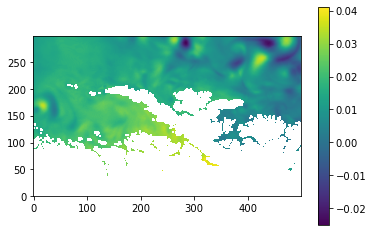

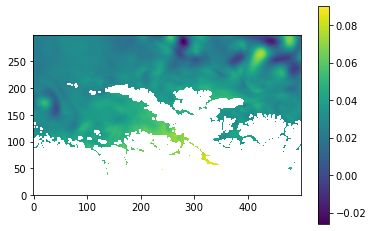

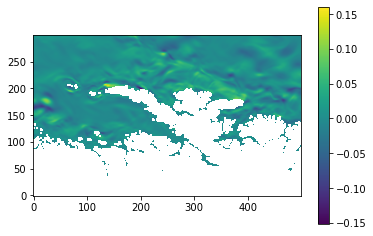

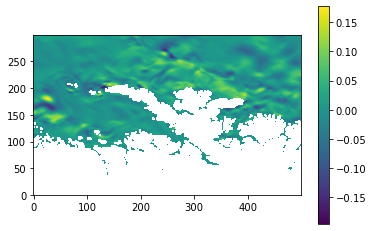

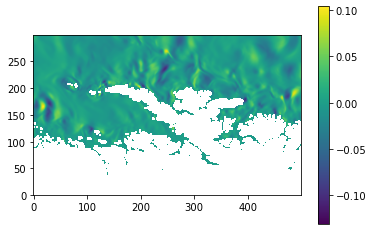

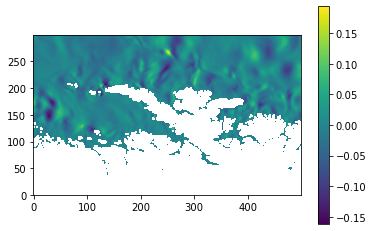

In [29]:
fig=plt.figure()
plt.imshow(diff_eta_1, origin="lower")
plt.colorbar()

fig=plt.figure()
plt.imshow(diff_eta_2, origin="lower")
plt.colorbar()

fig=plt.figure()
plt.imshow(diff_hu_1, origin="lower")
plt.colorbar()

fig=plt.figure()
plt.imshow(diff_hu_2, origin="lower")
plt.colorbar()

fig=plt.figure()
plt.imshow(diff_hv_1, origin="lower")
plt.colorbar()

fig=plt.figure()
plt.imshow(diff_hv_2, origin="lower")
plt.colorbar()

In [118]:
def plotSolution(fig, sim, comment="",
                 eta_max=2, hu_max=50, 
                 ax=None, sp=None):

    eta, hu, hv = sim.download(interior_domain_only=True)
    dx, dy, t = sim.dx, sim.dy, sim.t
    
    T = "Time = {:0>8} ({:s})".format(str(timedelta(seconds=int(t))), comment)

    return plotDirect(fig, eta, hu, hv, dx, dy, T, 
              comment, eta_max, hu_max, ax, sp)

def plotDirect(fig, eta, hu, hv, dx, dy, t, 
              comment="",
              eta_max=2, hu_max=50, 
              ax=None, sp=None):
    from datetime import timedelta
    fig.suptitle(t, 
                 fontsize=18,
                 horizontalalignment='left')
    
    ny, nx = eta.shape
    domain_extent = [0, nx*dx, 0, ny*dy]
   
    if (ax is None):
        ax = [None]*3
        sp = [None]*3
        
        ax[0] = plt.subplot(1, 3, 1)
        sp[0] = ax[0].imshow(eta, interpolation="none", origin='lower', 
                             cmap=plt.cm.BrBG, vmin=-eta_max, vmax=eta_max, 
                             extent=domain_extent)
        plt.colorbar(sp[0], shrink=0.9)
        plt.axis('image')
        plt.title("$\eta{}$")
        
        ax[1] = plt.subplot(1, 3, 2)
        sp[1] = ax[1].imshow(hu, interpolation="none", origin='lower', 
                            cmap=plt.cm.coolwarm, vmin=-hu_max, vmax=hu_max, 
                            extent=domain_extent)
        plt.colorbar(sp[1], shrink=0.9)
        plt.axis('image')
        plt.title("$hu$")

        ax[2] = plt.subplot(1, 3, 3)
        sp[2] = ax[2].imshow(hv, interpolation="none", origin='lower', 
                             cmap=plt.cm.coolwarm, vmin=-hu_max, vmax=hu_max, 
                             extent=domain_extent)
        plt.colorbar(sp[2], shrink=0.9)
        plt.axis('image')
        plt.title("$hv$")
            
    else:        
        #Update plots
        fig.sca(ax[0])
        sp[0].set_data(eta)
        
        fig.sca(ax[1])
        sp[1].set_data(hu)
        
        fig.sca(ax[2])
        sp[2].set_data(hv)
        
    return ax, sp


def sim_animation(sim, T, anim_dt, hu_max=20.0, eta_max=0.5, comment=""):
    """
    Creates an animation of the simulator based on T frames, with frames sub_dt*sim.dt appart.
    """

    
    #Create figure and plot initial conditions
    fig = plt.figure(figsize=(14, 4))
    ax, sp = plotSolution(fig, sim, comment=comment,
                          eta_max=eta_max, hu_max=hu_max)
    #Helper function which simulates and plots the solution
    def animate(i):
        if (i>0):
            t = sim.step(anim_dt)
        else:
            t = 0.0

        plotSolution(fig, sim, comment=comment, ax=ax, sp=sp)
        print(".", end='')
        
    #Matplotlib for creating an animation
    anim = animation.FuncAnimation(fig, animate, range(T), interval=100)
    plt.close(fig)
    return anim



In [119]:

def plotDailyMean(fig, url, comment="", eta_max=2, hu_max=50, 
                 ax=None, sp=None):
    ds = xr.open_dataset(url)
    
    eta = ds.zeta.isel(X=slice(case_info["x0"], case_info["x1"]), Y=slice(case_info["y0"], case_info["y1"]), time=0).data
    hu  = ds.ubar.isel(X=slice(case_info["x0"], case_info["x1"]), Y=slice(case_info["y0"], case_info["y1"]), time=0).data
    hv  = ds.vbar.isel(X=slice(case_info["x0"], case_info["x1"]), Y=slice(case_info["y0"], case_info["y1"]), time=0).data

    dx, dy = 800, 800
    t = str(ds.time[0].data)

    return plotDirect(fig, eta, hu, hv, dx, dy, t, 
              comment, eta_max, hu_max, ax, sp)

def nc_animation(url, comment=""):
    
    #Create figure and plot initial conditions
    fig = plt.figure(figsize=(20, 6))
    url_0 = url.replace("BANANA", "01") 
    ax, sp = plotDailyMean(fig, url_0, comment=comment,
                          eta_max=0.5, hu_max=0.5)
    
    
     #Helper function which simulates and plots the solution
    def animate(i):
        if (i<1):
            url1 = url.replace("BANANA", "01") 
        elif i < 9:
            url1 = url.replace("BANANA", str("0") + str(i+1)) 
        else:
            url1 = url.replace("BANANA", str(i+1)) 
        

        plotDailyMean(fig, url1, comment=comment, ax=ax, sp=sp,  eta_max=0.5, hu_max=0.5)
        print(".", end='')
    
    anim = animation.FuncAnimation(fig, animate, range(29), interval=100)
    plt.close(fig)
    return anim

url  = 'https://thredds.met.no/thredds/dodsC/fou-hi/norkyst800m/NorKyst-800m_ZDEPTHS_avg.an.201907BANANA00.nc'
nc_animation(url)



..............................

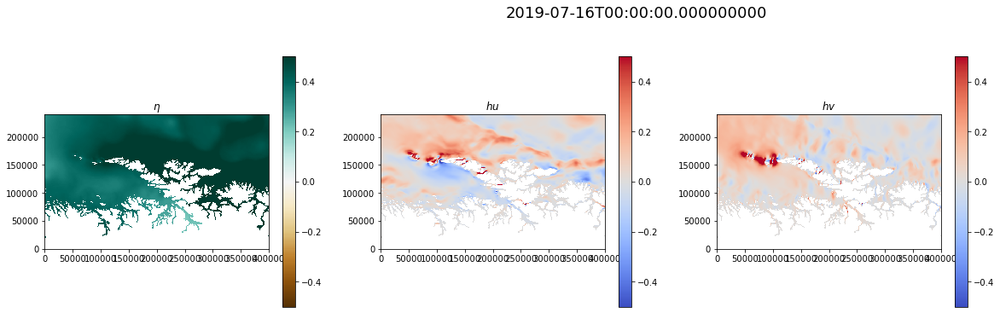

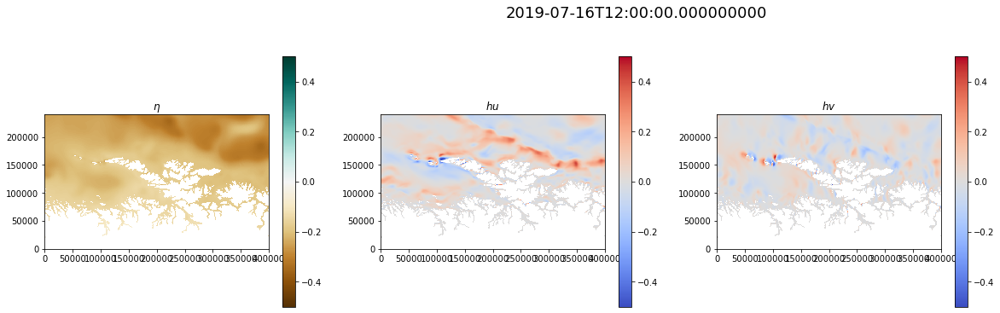

In [63]:
source_url_full = 'https://thredds.met.no/thredds/dodsC/fou-hi/norkyst800m-1h/NorKyst-800m_ZDEPTHS_his.an.2019071600.nc'

fig = plt.figure(figsize=(20, 6))
ax, sp = plotDailyMean(fig, source_url_full, comment="",
                          eta_max=0.5, hu_max=0.5)

fig = plt.figure(figsize=(20, 6))
ax, sp = plotDailyMean(fig, source_url, comment="",
                          eta_max=0.5, hu_max=0.5)

# Initialize a sim from daily mean

In [110]:
from importlib import reload
reload(NetCDFInitialization)

data_args = NetCDFInitialization.getInitialConditions(source_url, case_info["x0"], case_info["x1"], case_info["y0"], case_info["y1"], download_data=False)


In [128]:
if "sim" in globals():
    sim.cleanUp()
    
sim = CDKLM16.CDKLM16(gpu_ctx, dt=0.0, write_netcdf=False,  **NetCDFInitialization.removeMetadata(data_args))
T = 24
anim_dt = 3600
sim_animation(sim, T, anim_dt, hu_max=100.0, eta_max=0.5, comment=case_info["name"])

This will give inaccurate angle along the border!
This will give inaccurate coriolis along the border!


.........................

In [124]:
if "sim" in globals():
    sim.cleanUp()
    
sim = CDKLM16.CDKLM16(gpu_ctx, dt=0.0, write_netcdf=False,  **NetCDFInitialization.removeMetadata(data_args))
T = 24*3
anim_dt = 3600
sim_animation(sim, T, anim_dt, hu_max=100.0, eta_max=0.5, comment=case_info["name"])

This will give inaccurate angle along the border!
This will give inaccurate coriolis along the border!


.........................................................................

In [126]:
if "sim" in globals():
    sim.cleanUp()
    
sim = CDKLM16.CDKLM16(gpu_ctx, dt=0.0, write_netcdf=False,  **NetCDFInitialization.removeMetadata(data_args))
T = 24*10/3
anim_dt = 3600*3
sim_animation(sim, T, anim_dt, hu_max=100.0, eta_max=0.5, comment=case_info["name"])

This will give inaccurate angle along the border!
This will give inaccurate coriolis along the border!


...................................................................................................................................................................................................................................

Animation size has reached 21053181 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


..............

In [86]:
ds_full = xr.open_dataset(source_url_full)
ds_full

<xarray.Dataset>
Dimensions:                  (s_rho: 35, s_w: 36, X: 2602, Y: 902, depth: 16, time: 24)
Coordinates:
  * X                        (X) float64 0.0 800.0 ... 2.08e+06 2.081e+06
  * Y                        (Y) float64 0.0 800.0 1.6e+03 ... 7.2e+05 7.208e+05
  * depth                    (depth) float64 0.0 3.0 10.0 ... 1e+03 2e+03 3e+03
  * time                     (time) datetime64[ns] 2019-07-16 ... 2019-07-16T...
    lat                      (Y, X) float64 ...
    lon                      (Y, X) float64 ...
Dimensions without coordinates: s_rho, s_w
Data variables: (12/21)
    Cs_r                     (s_rho) float64 ...
    Cs_w                     (s_w) float64 ...
    forecast_reference_time  datetime64[ns] ...
    hc                       float64 ...
    projection_stere         int32 ...
    AKs                      (time, depth, Y, X) float32 ...
    ...                       ...
    ubar                     (time, Y, X) float32 ...
    v                        (time, depth, Y, X) float32 ...
    v_northward              (time, depth, Y, X) float32 ...
    vbar                     (time, Y, X) float32 ...
    w                        (time, depth, Y, X) float32 ...
    zeta                     (time, Y, X) float32 ...
Attributes: (12/34)
    file:                            /home/metno_op/run/norkyst-800m_2017/oce...
    type:                            ROMS/TOMS history file
    title:                           NorKyst-800m - ROMS
    var_info:                        /home/metno_op/sea/ROMS/metroms/apps/com...
    rst_file:                        /home/metno_op/run/norkyst-800m_2017/oce...
    his_file:                        /home/metno_op/run/norkyst-800m_2017/oce...
    ...                              ...
    CPP_options:                     NORKYST800M, ADD_FSOBC, ADD_M2OBC, ALBED...
    Conventions:                     CF-1.4, SGRID-0.3
    history:                         Tue Jul 16 05:56:54 2019: ncks -O --4 -d...
    history_of_appended_files:       Tue Jul 16 05:56:50 2019: Appended file ...
    NCO:                             "4.5.4"
    DODS_EXTRA.Unlimited_Dimension:  time

#  Investigating s-rho

In [91]:
slevel_url = "https://thredds.met.no/thredds/dodsC/fou-hi/new_norkyst800m/his/ocean_his.an.20190716.nc"
#https://thredds.met.no/thredds/dodsC/fou-hi/norkyst800m/NorKyst-800m_ZDEPTHS_avg.an.2019071600.nc
slevel_ds = xr.open_dataset(slevel_url)
slevel_ds

<xarray.Dataset>
Dimensions:                  (ocean_time: 24, s_w: 36, eta_rho: 902, xi_rho: 2602, tracer: 2, s_rho: 35, boundary: 4, eta_psi: 901, xi_psi: 2601, eta_u: 902, xi_u: 2601, eta_v: 901, xi_v: 2602)
Coordinates:
    lat_psi                  (eta_psi, xi_psi) float64 ...
    lat_rho                  (eta_rho, xi_rho) float64 ...
    lat_u                    (eta_u, xi_u) float64 ...
    lat_v                    (eta_v, xi_v) float64 ...
    lon_psi                  (eta_psi, xi_psi) float64 ...
    lon_rho                  (eta_rho, xi_rho) float64 ...
    lon_u                    (eta_u, xi_u) float64 ...
    lon_v                    (eta_v, xi_v) float64 ...
  * ocean_time               (ocean_time) datetime64[ns] 2019-07-16 ... 2019-...
  * s_rho                    (s_rho) float64 -0.9857 -0.9571 ... -0.01429
  * s_w                      (s_w) float64 -1.0 -0.9714 -0.9429 ... -0.02857 0.0
Dimensions without coordinates: eta_rho, xi_rho, tracer, boundary, eta_psi, xi_psi, eta_u, xi_u, eta_v, xi_v
Data variables: (12/105)
    AKs                      (ocean_time, s_w, eta_rho, xi_rho) float32 ...
    Akk_bak                  float64 ...
    Akp_bak                  float64 ...
    Akt_bak                  (tracer) float64 ...
    Akv_bak                  float64 ...
    Charnok_alpha            float64 ...
    ...                       ...
    v                        (ocean_time, s_rho, eta_v, xi_v) float32 ...
    v_northward              (ocean_time, s_rho, eta_rho, xi_rho) float32 ...
    vbar                     (ocean_time, eta_v, xi_v) float32 ...
    w                        (ocean_time, s_w, eta_rho, xi_rho) float32 ...
    xl                       float64 ...
    zeta                     (ocean_time, eta_rho, xi_rho) float32 ...
Attributes: (12/34)
    file:                            /home/metno_op/run/norkyst-800m_2017/oce...
    format:                          netCDF-4/HDF5 file
    Conventions:                     CF-1.4, SGRID-0.3
    type:                            ROMS/TOMS history file
    title:                           NorKyst-800m - ROMS
    var_info:                        /home/metno_op/sea/ROMS/metroms/apps/com...
    ...                              ...
    tiling:                          032x016
    history:                         Tue Jul 16 04:02:05 2019: ncks -O --4 --...
    ana_file:                        ROMS/Functionals/ana_btflux.h, ROMS/Func...
    CPP_options:                     NORKYST800M, ADD_FSOBC, ADD_M2OBC, ALBED...
    NCO:                             "4.5.4"
    DODS_EXTRA.Unlimited_Dimension:  ocean_time

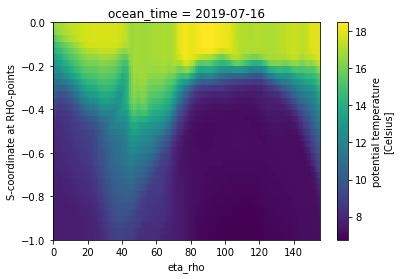

In [93]:
slevel_ds.temp.isel(ocean_time=0, xi_rho=280, eta_rho=slice(40,196)).plot() 
# (ocean_time, s_rho, eta_rho, xi_rho)

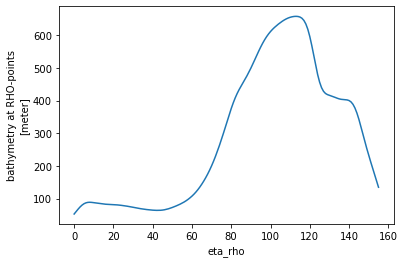

In [96]:
slevel_ds.h.isel(xi_rho=280, eta_rho=slice(40,196)).plot() 


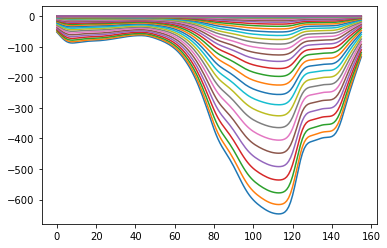

In [106]:
cs_r = slevel_ds.Cs_r.data 
h = slevel_ds.h.isel(xi_rho=280, eta_rho=slice(40,196))

for i in range(len(cs_r)):
    plt.plot(h*cs_r[i])